# Data classes

In [1]:
import os
import pandas as pd
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import torchvision.transforms as transforms
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from collections import Counter
import torchvision.transforms as T
import numpy as np


## Using spacy pretrained model for tokenizing

In [2]:
spacy_eng = spacy.load("en_core_web_sm")

In [3]:
data_location="/kaggle/input/flickr8kimagescaptions/flickr8k"

In [4]:
import pandas as pd
df=pd.read_csv(data_location+"/captions.txt")

In [5]:
import os
print(os.listdir("/kaggle/input/flickr8kimagescaptions/flickr8k"))

['captions.txt', 'images']


In [6]:
class Vocab:
    def __init__(self,threshold_freq):
        #setting the pre-reserved tokens int to string tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        
        #string to int tokens
        #its reverse dict self.itos
        self.stoi = {v:k for k,v in self.itos.items()}
        
        self.freq_threshold = threshold_freq
        
    def __len__(self): return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4
        
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]

In [7]:
class flickrdataset(Dataset):
    def __init__(self,root_dir,captions_file,transform=None,frequency_threshold=5):
        self.root_dir=root_dir
        self.df=pd.read_csv(captions_file)
        self.transform=transform
        self.imgs=self.df["image"]
        self.captions=self.df["caption"]
        
        self.vocab = Vocab(frequency_threshold)
        self.vocab.build_vocab(self.captions.tolist())
    def __len__(self):
        return len(self.df)
    def __getitem__(self,idx):
        captions=self.captions[idx]
        images=self.imgs[idx]
        img=Image.open(self.root_dir+"/"+images).convert("RGB")
        if self.transform:
            img=self.transform(img)
        cap_vec=[]
        cap_vec+=[self.vocab.stoi["<SOS>"]]
        cap_vec+=self.vocab.numericalize(captions)
        cap_vec+=[self.vocab.stoi["<EOS>"]]
        return img,torch.tensor(cap_vec)

## Pipeline to process image

In [8]:
transforms=T.Compose([T.Resize(256),                     
    T.RandomCrop(224),                 
    T.ToTensor()                               
    #T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
                     ]
                    )

In [9]:
import matplotlib.pyplot as plt
def show_image(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

In [10]:
dataset =  flickrdataset(
    root_dir = data_location+"/images",
    captions_file = data_location+"/captions.txt",
    transform=transforms
)

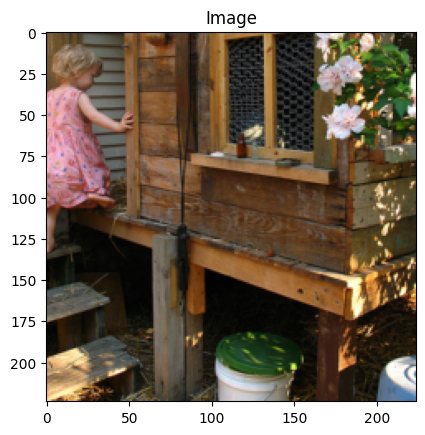

Token: tensor([  1,   4,  28,   8,   4, 195, 151,  17,  32,  67,   4, 353,  11, 711,
          8,  24,   3, 496,   5,   2])
Sentence:
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']


In [11]:
img,cap=dataset[0]
show_image(img,"Image")
print("Token:",cap)
print("Sentence:")
print([dataset.vocab.itos[token] for token in cap.tolist()])

In [12]:
BATCH_SIZE = 256
NUM_WORKER = 2

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]
from torch.utils.data.sampler import SubsetRandomSampler
def collate_function(batch):

    imgs = [item[0].unsqueeze(0) for item in batch]
    imgs = torch.cat(imgs,dim=0)
    targets = [item[1] for item in batch]
    targets = pad_sequence(targets, batch_first=True, padding_value=dataset.vocab.stoi["<PAD>"])
    return imgs,targets

validation_split = .2
shuffle_dataset = True
random_seed= 42

# Creating data indices for training and validation splits:
dataset_size = len(dataset)
indices = list(range(dataset_size))
split = int(np.floor(validation_split * dataset_size))
if shuffle_dataset :
    np.random.seed(random_seed)
    np.random.shuffle(indices)
train_indices, val_indices = indices[split:], indices[:split]

# Creating PT data samplers and loaders:
train_sampler = SubsetRandomSampler(train_indices)
valid_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE, 
                                           sampler=train_sampler,num_workers=NUM_WORKER,collate_fn=collate_function)
validation_loader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE,
                                                sampler=valid_sampler,num_workers=NUM_WORKER,collate_fn=collate_function)

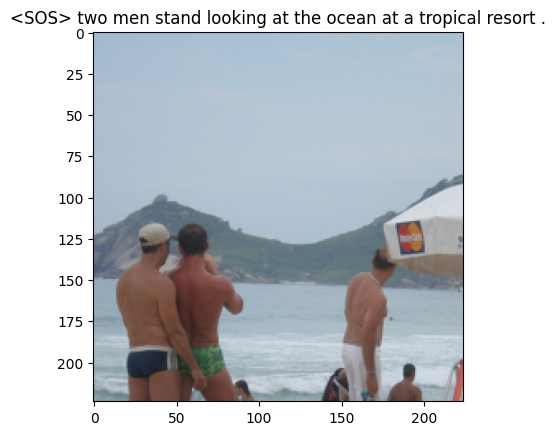

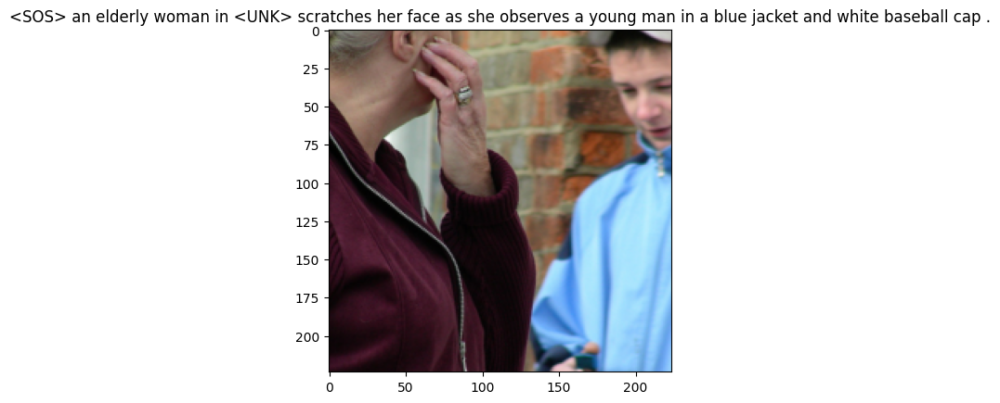

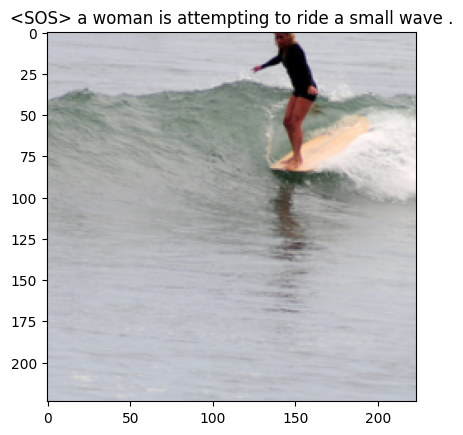

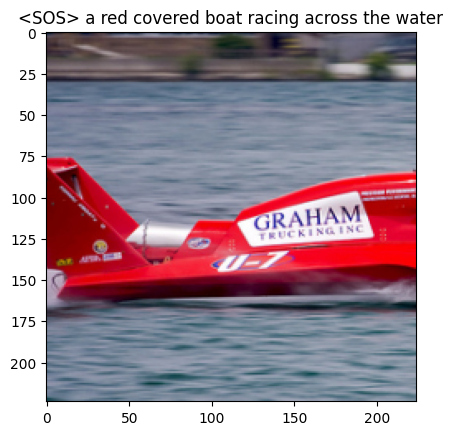

In [13]:
dataiter=next(iter(train_loader))
images, captions_ = dataiter

for k in range(4):
    img,captions=images[k],captions_[k]
    show_image(img," ".join([dataset.vocab.itos[token] for token in captions.tolist() if token!=dataset.vocab.stoi["<EOS>"]and token!=dataset.vocab.stoi["<PAD>"]]))
    plt.show()

# Define Model Classes

In [14]:
import torch
import torch.nn as nn
import torchvision.models as models
from torchvision.models.resnet import ResNet50_Weights

class EncoderCNN(nn.Module):
    def __init__(self):
        super(EncoderCNN, self).__init__()
        resnet = models.resnet50(weights=ResNet50_Weights.DEFAULT)
        for p in resnet.parameters():
            p.requires_grad_(False)
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)

    def forward(self, images):
        features = self.resnet(images)
        features = features.permute(0, 2, 3, 1)
        features = features.view(features.size(0), -1, features.size(-1))
        return features  # (batch_size, 49, 2048)


class DecoderRNN(nn.Module):
    def __init__(self, embed_size, vocab_size, encoder_dim, decoder_dim, drop_prob=0.3):
        super(DecoderRNN, self).__init__()

        self.vocab_size = vocab_size
        self.decoder_dim = decoder_dim

        self.embedding = nn.Embedding(vocab_size, embed_size)

        self.init_h = nn.Linear(encoder_dim, decoder_dim)
        self.init_c = nn.Linear(encoder_dim, decoder_dim)
        self.lstm_cell = nn.LSTMCell(embed_size, decoder_dim, bias=True)
        self.fcn = nn.Linear(decoder_dim, vocab_size)
        self.drop = nn.Dropout(drop_prob)

    def forward(self, features, captions):
        embeds = self.embedding(captions)
        h, c = self.init_hidden_state(features)

        seq_length = len(captions[0]) - 1
        batch_size = captions.size(0)

        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(features.device)

        for s in range(seq_length):
            lstm_input = embeds[:, s]
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            preds[:, s] = output

        return preds

    def generate_caption(self, features, max_len=20, vocab=None):
        batch_size = features.size(0)
        h, c = self.init_hidden_state(features)
        word = torch.tensor(vocab.stoi['<SOS>']).view(1, -1).to(features.device)
        embeds = self.embedding(word)
        captions = []

        for i in range(max_len):
            lstm_input = embeds[:, 0]
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_size, -1)
            predicted_word_idx = output.argmax(dim=1)
            captions.append(predicted_word_idx.item())

            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break

            embeds = self.embedding(predicted_word_idx.unsqueeze(0))

        return [vocab.itos[idx] for idx in captions]

    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)
        c = self.init_c(mean_encoder_out)
        return h, c
    
    
class EncoderDecoder(nn.Module):
    def __init__(self, embed_size, vocab_size, decoder_dim, drop_prob=0.3):
        super(EncoderDecoder, self).__init__()
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            embed_size=embed_size,
            vocab_size=vocab_size,
            encoder_dim=2048,  # Assuming the encoder output size is 2048
            decoder_dim=decoder_dim,
            drop_prob=drop_prob
        )

    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

In [15]:
def save_model(model,num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }

    torch.save(model_state,'no_attention_model.pth')

# Train

In [16]:
print_every = 100

def train(model, learning_rate, num_epochs, train_loader, dataset):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    step = 0

    criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi['<PAD>'])
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    model.to(device)
    model.train()
    losses = []
    for epoch in range(1, num_epochs + 1):
        losses_per_epoch = 0
        for idx, (image, captions) in enumerate(train_loader):
            image, captions = image.to(device), captions.to(device)
            optimizer.zero_grad()

            # Forward pass
            features = model.encoder(image)
            outputs = model.decoder(features, captions)

            # Calculate loss
            targets = captions[:, 1:]
            loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
            losses_per_epoch += loss.item()
            
            # Backward pass and optimization
            loss.backward()
            optimizer.step()

            if (idx + 1) % print_every == 0:
                print("Epoch: {} loss: {:.5f}".format(epoch, loss.item()))

                # Generate caption
                model.eval()
                with torch.no_grad():
                    dataiter = iter(validation_loader)
                    img, _ = next(dataiter)
                    features = model.encoder(img[0:1].to(device))
                    caps = model.decoder.generate_caption(features, vocab=dataset.vocab)
                    caption = ' '.join(caps)
                    show_image(img[0], title=caption)

                model.train()
        losses.append(losses_per_epoch)
        save_model(model, epoch)
    # Plot losses
    plt.plot(range(1, num_epochs + 1), losses, label='Train Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Losses')
    plt.legend()
    plt.show()
# Define parameters
vocab_size = len(dataset.vocab)
embed_size= 300
decoder_dim= 512


num_epochs = 100
hidden_size = 512
encoder_dim= 2048
learning_rate = 3e-4

# Initialize models
model_no_attention = EncoderDecoder(embed_size, vocab_size, decoder_dim )

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 146MB/s]


Epoch: 1 loss: 4.12813


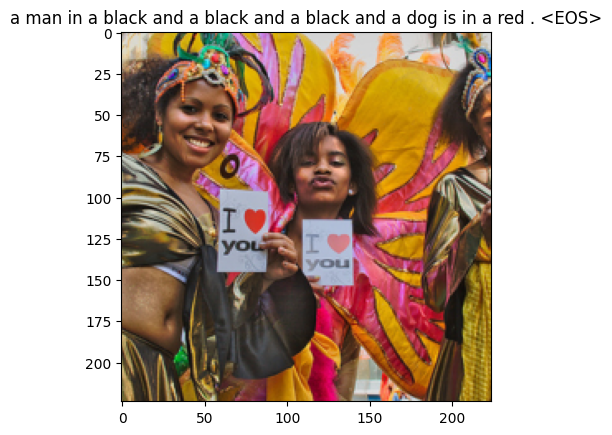

Epoch: 2 loss: 3.56521


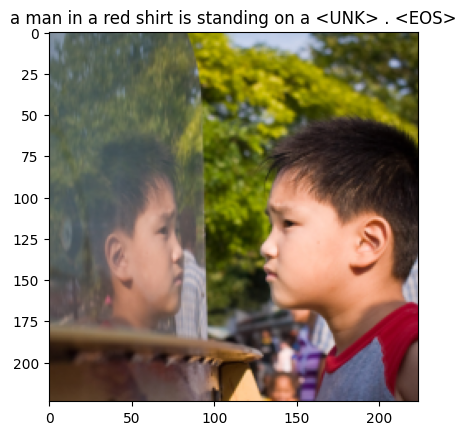

Epoch: 3 loss: 3.33287


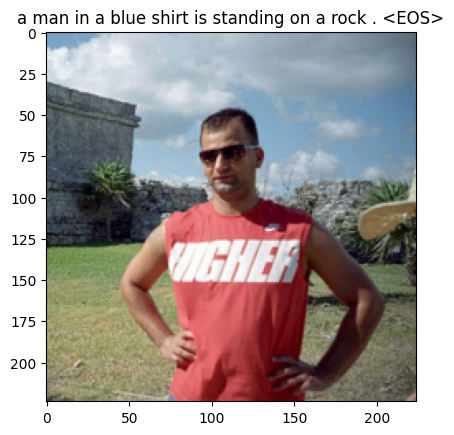

Epoch: 4 loss: 3.14789


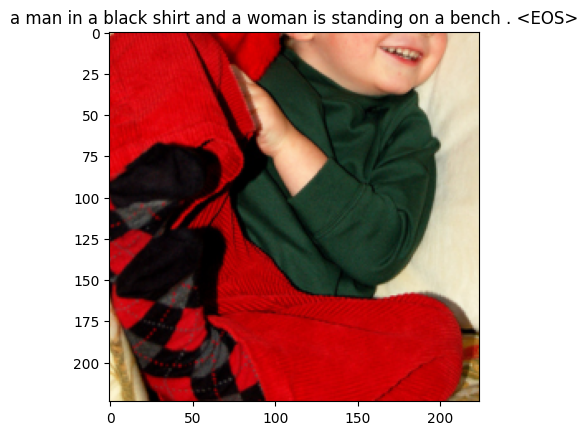

Epoch: 5 loss: 2.99793


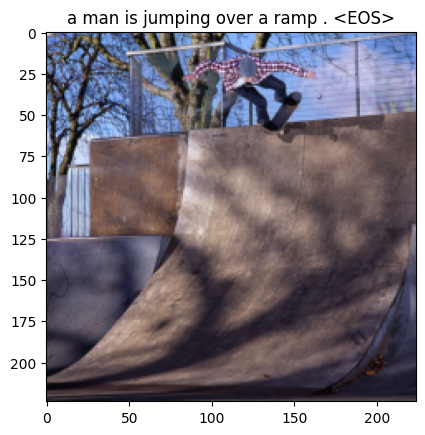

Epoch: 6 loss: 2.95036


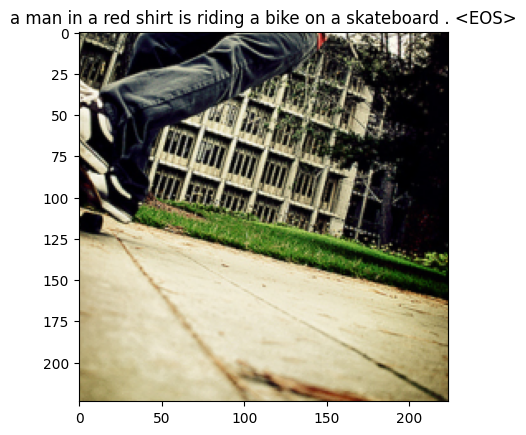

Epoch: 7 loss: 2.80729


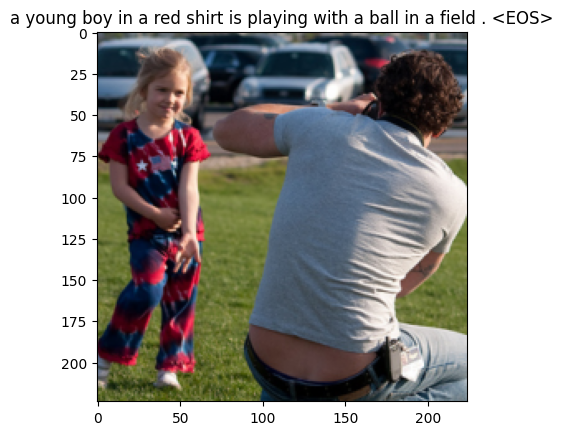

Epoch: 8 loss: 2.75706


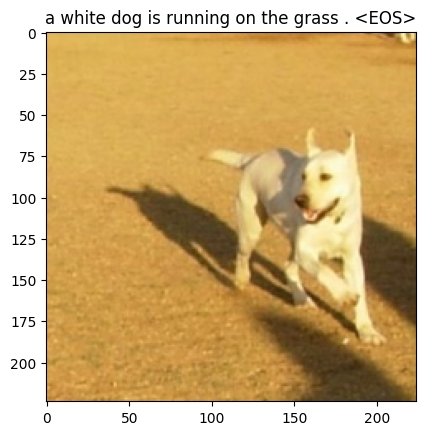

Epoch: 9 loss: 2.66515


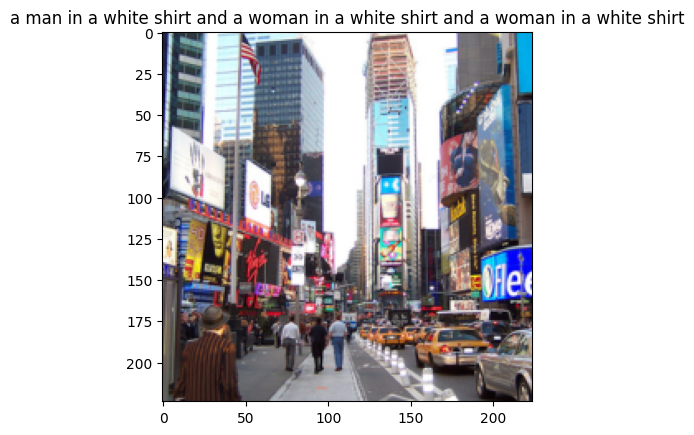

Epoch: 10 loss: 2.52081


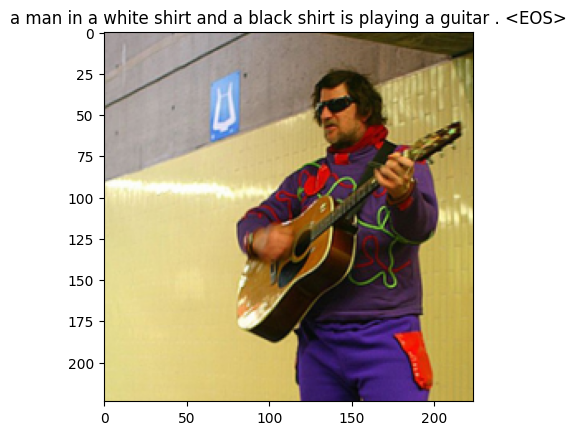

Epoch: 11 loss: 2.48916


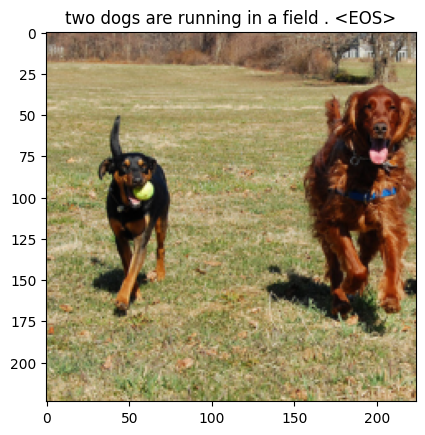

Epoch: 12 loss: 2.48253


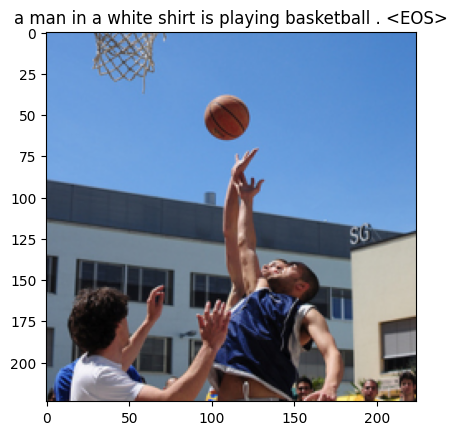

Epoch: 13 loss: 2.45424


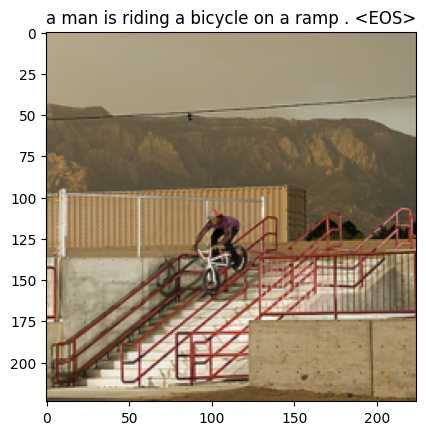

Epoch: 14 loss: 2.34200


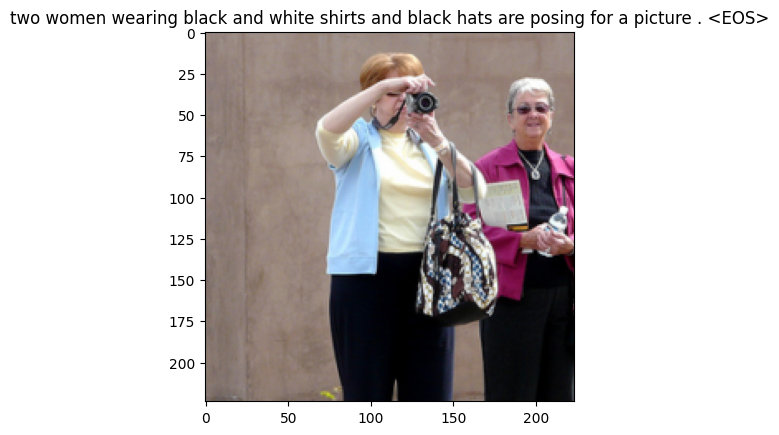

Epoch: 15 loss: 2.36401


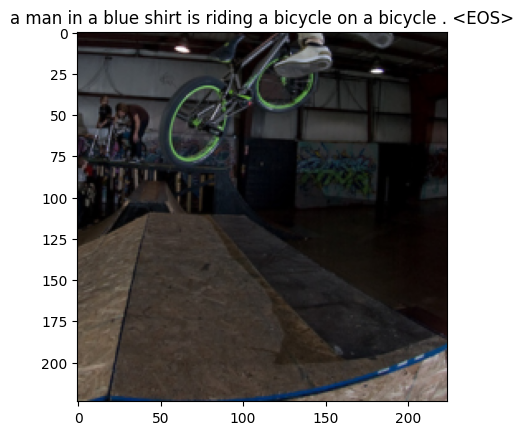

Epoch: 16 loss: 2.37089


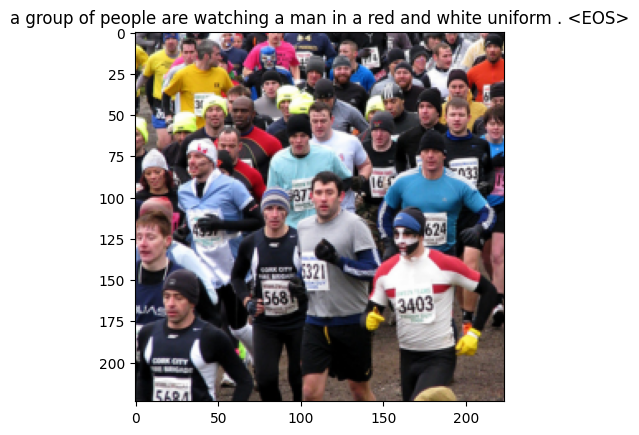

Epoch: 17 loss: 2.33364


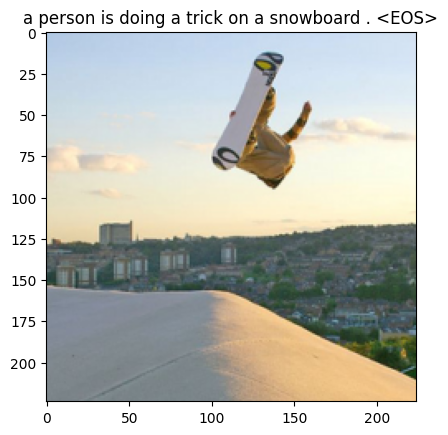

Epoch: 18 loss: 2.21586


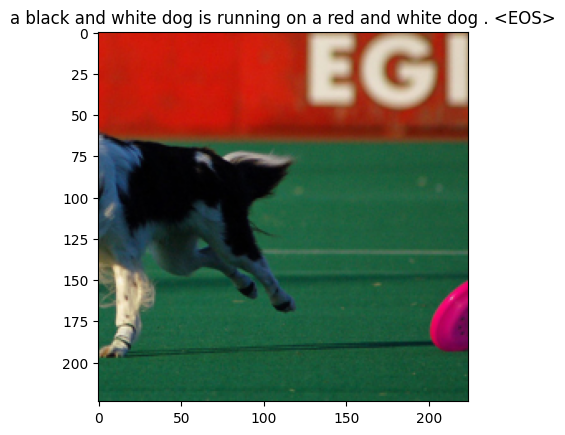

Epoch: 19 loss: 2.18182


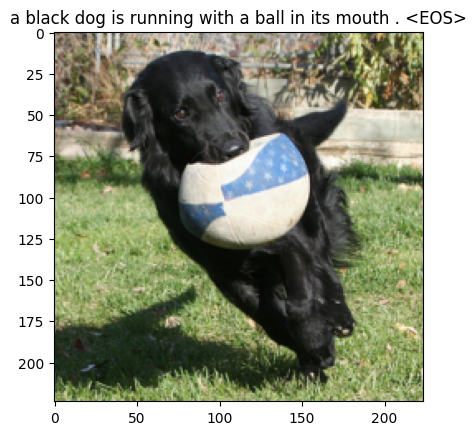

Epoch: 20 loss: 2.16655


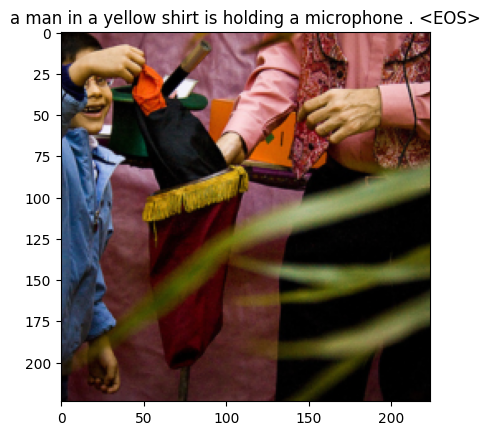

Epoch: 21 loss: 2.09135


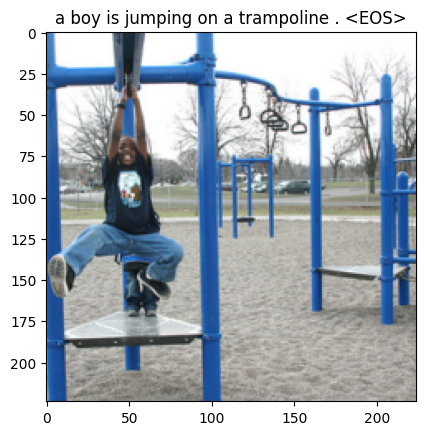

Epoch: 22 loss: 2.11139


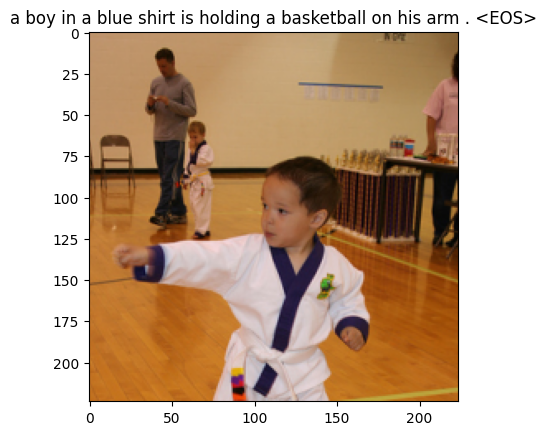

Epoch: 23 loss: 2.10619


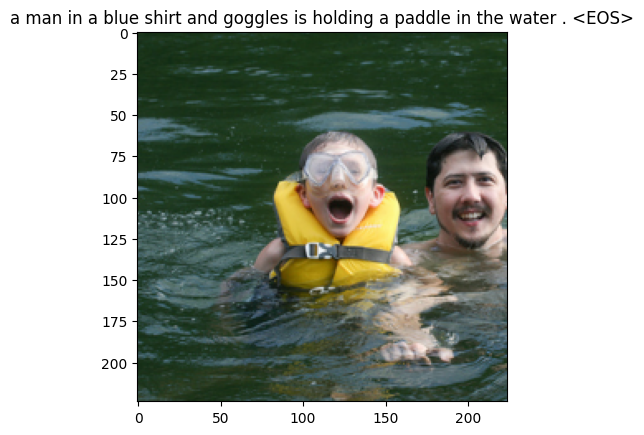

Epoch: 24 loss: 2.01960


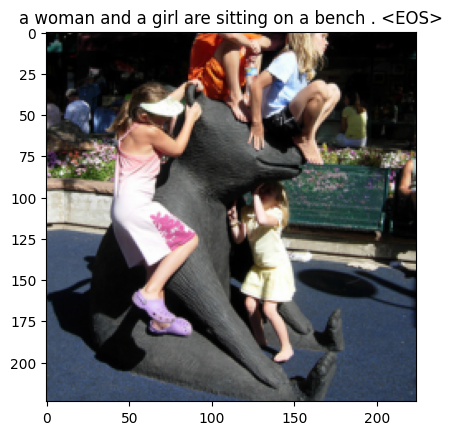

Epoch: 25 loss: 2.01560


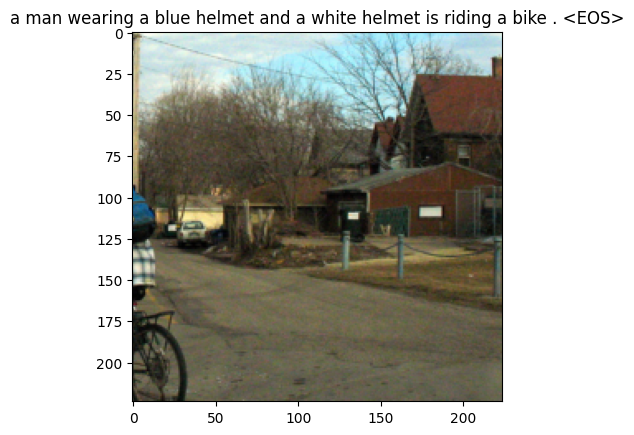

Epoch: 26 loss: 1.99818


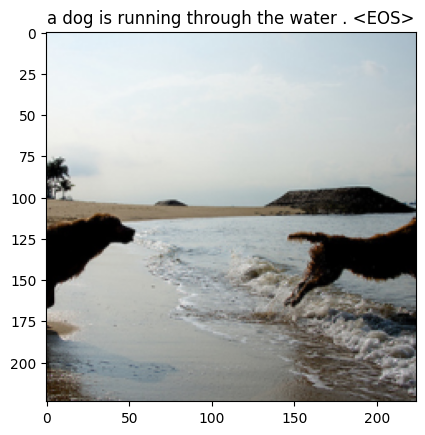

Epoch: 27 loss: 1.98520


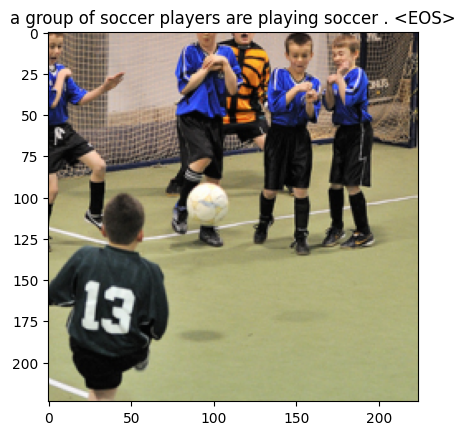

Epoch: 28 loss: 1.93933


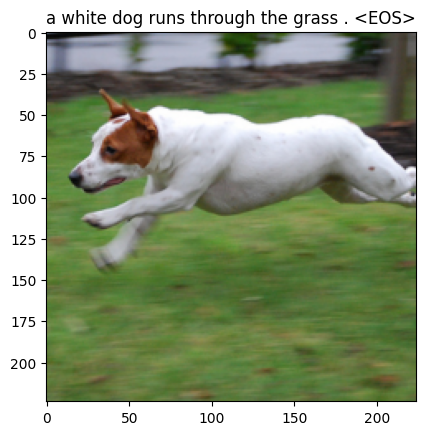

Epoch: 29 loss: 1.91144


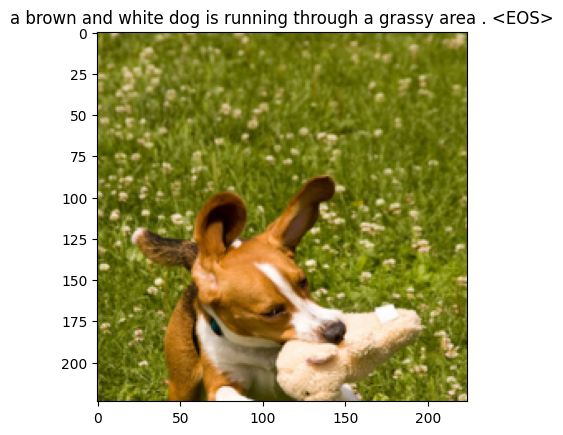

Epoch: 30 loss: 1.78631


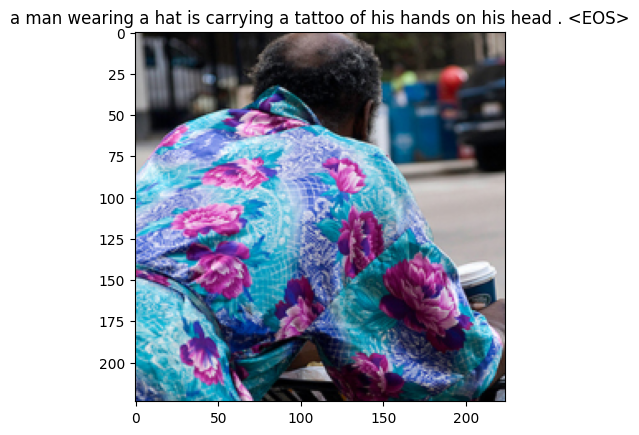

Epoch: 31 loss: 1.82139


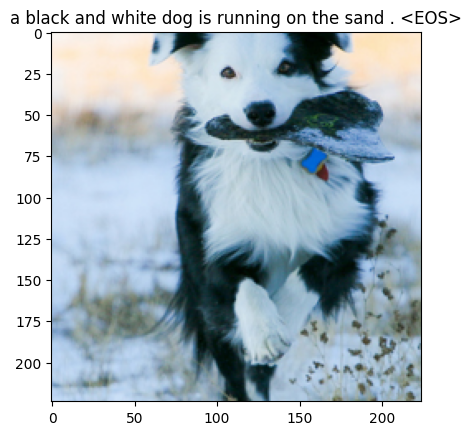

Epoch: 32 loss: 1.78631


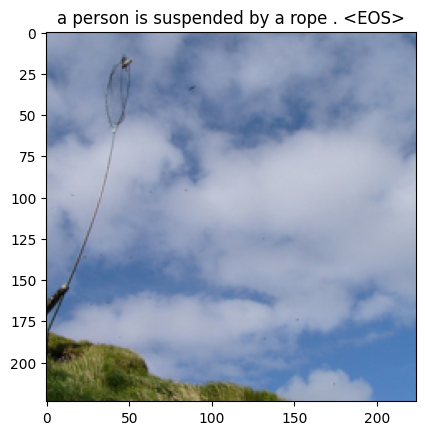

Epoch: 33 loss: 1.79515


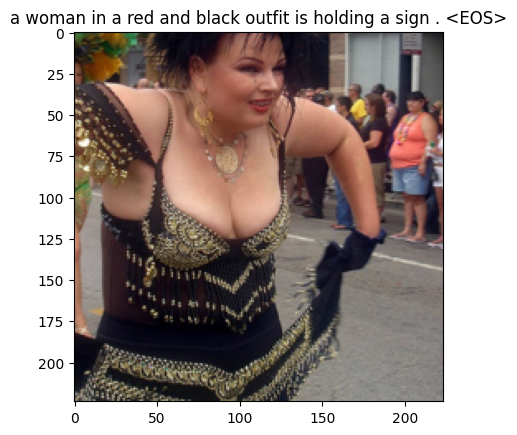

Epoch: 34 loss: 1.77915


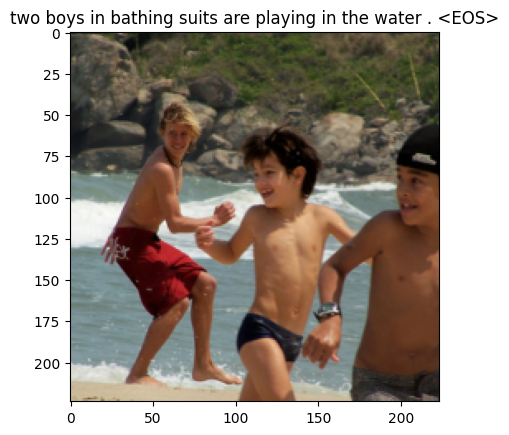

Epoch: 35 loss: 1.72302


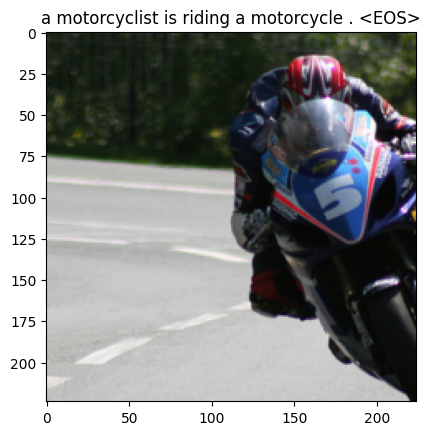

Epoch: 36 loss: 1.72483


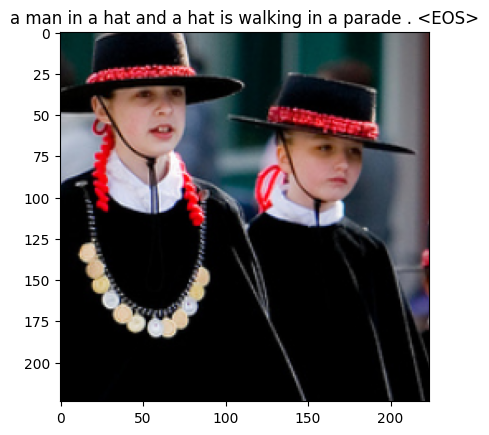

Epoch: 37 loss: 1.68850


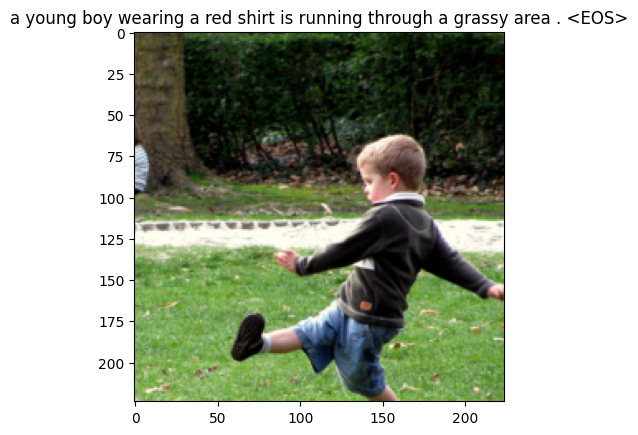

Epoch: 38 loss: 1.61746


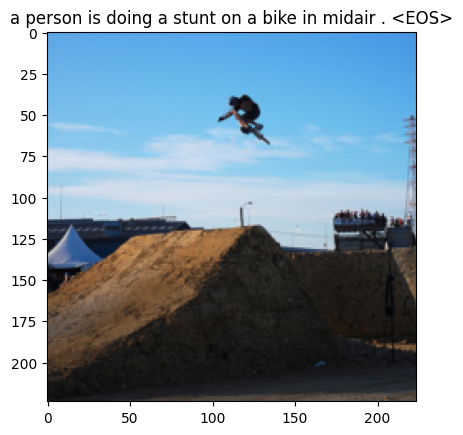

Epoch: 39 loss: 1.63347


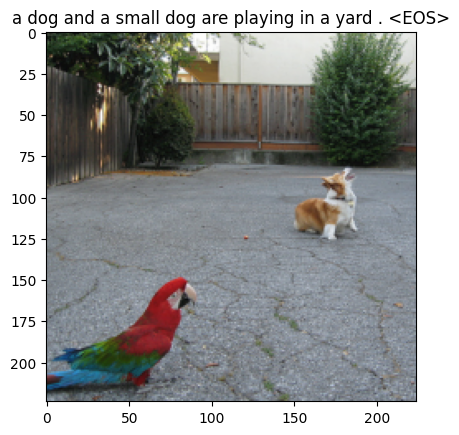

Epoch: 40 loss: 1.64307


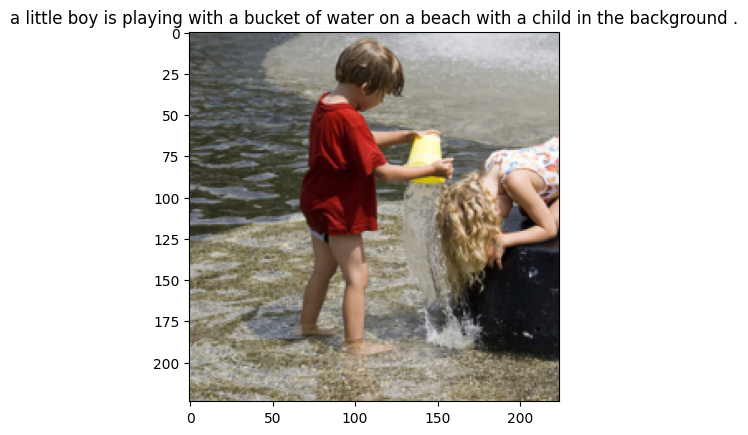

Epoch: 41 loss: 1.57273


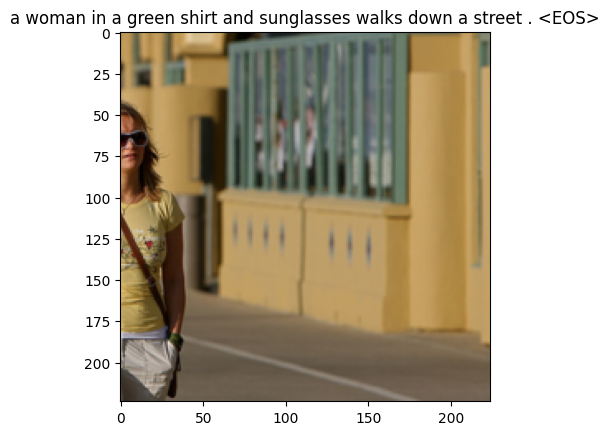

Epoch: 42 loss: 1.54961


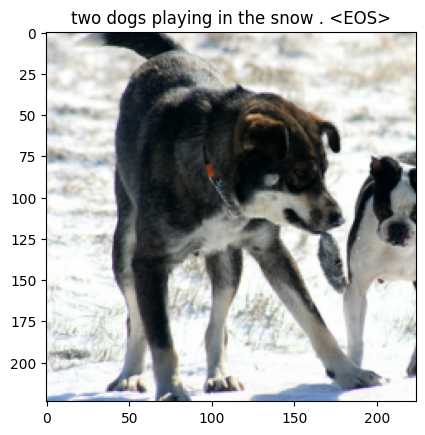

Epoch: 43 loss: 1.58536


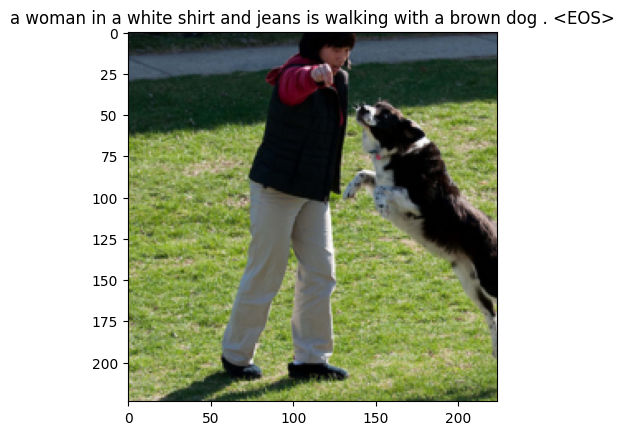

Epoch: 44 loss: 1.54426


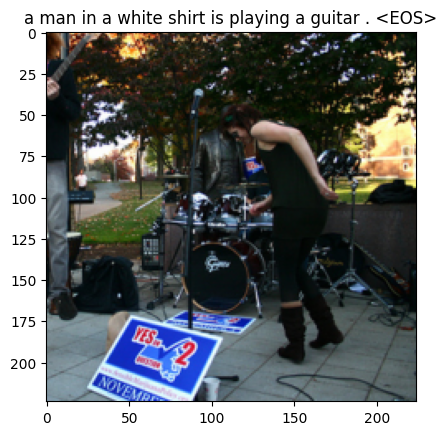

Epoch: 45 loss: 1.53520


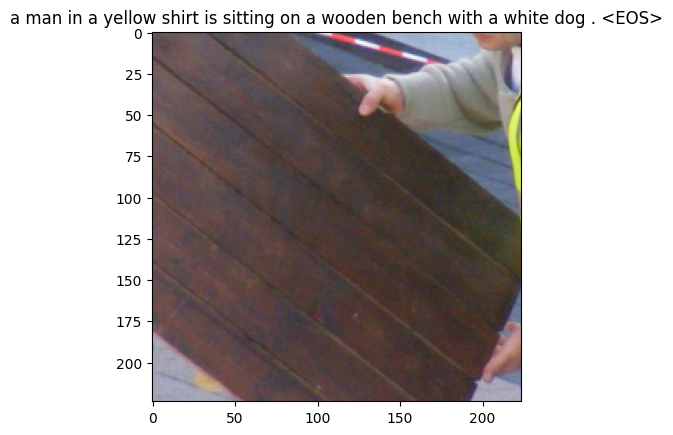

Epoch: 46 loss: 1.51259


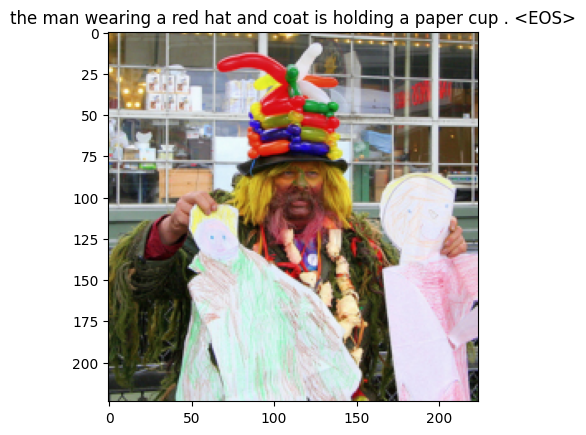

Epoch: 47 loss: 1.45885


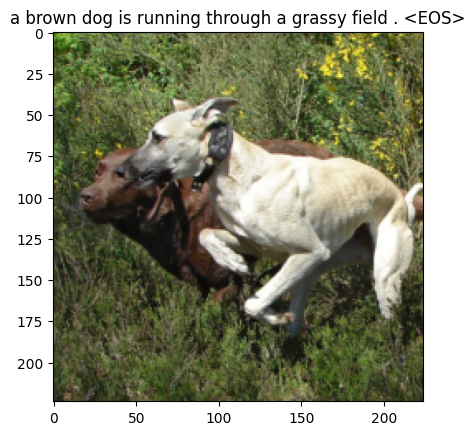

Epoch: 48 loss: 1.43945


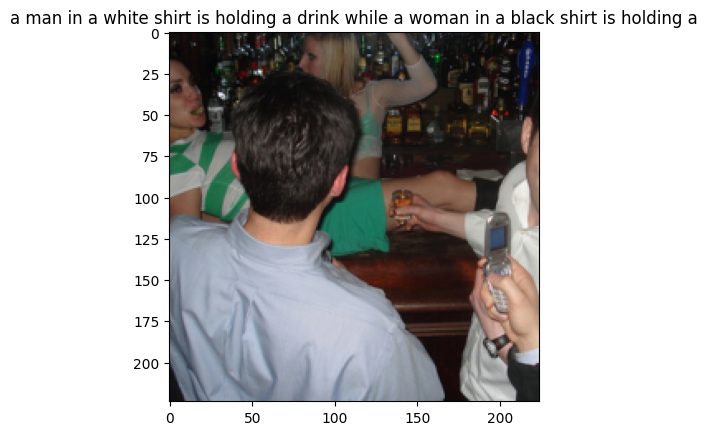

Epoch: 49 loss: 1.44434


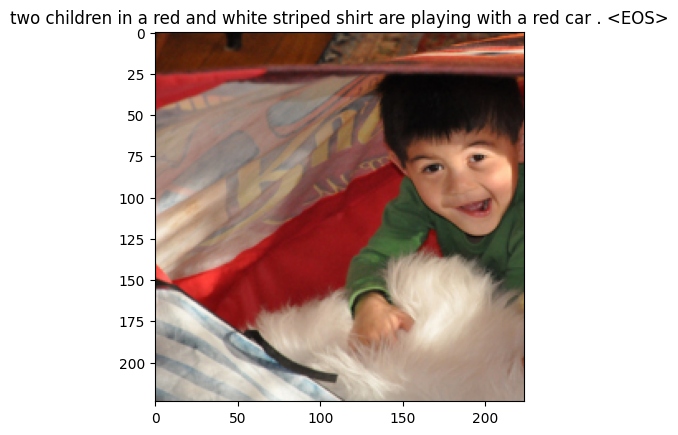

Epoch: 50 loss: 1.45395


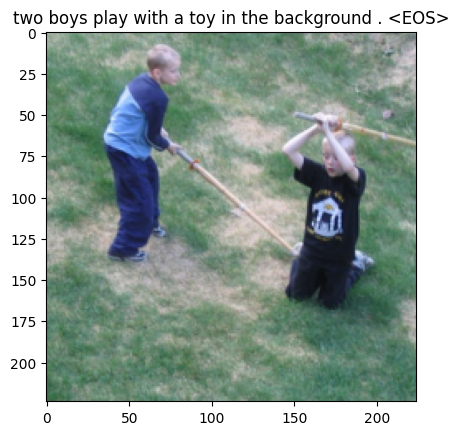

Epoch: 51 loss: 1.46911


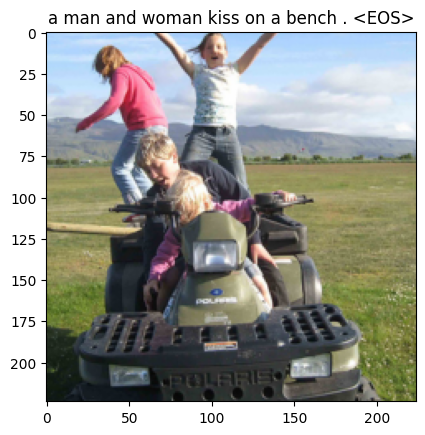

Epoch: 52 loss: 1.40326


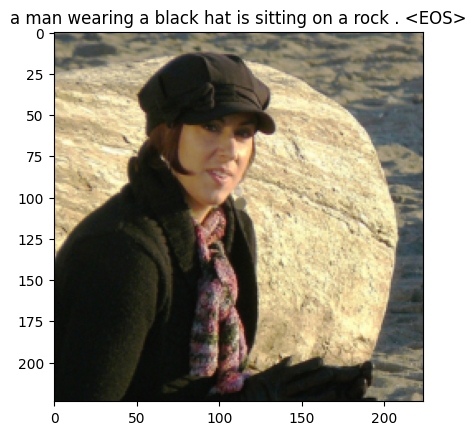

Epoch: 53 loss: 1.39855


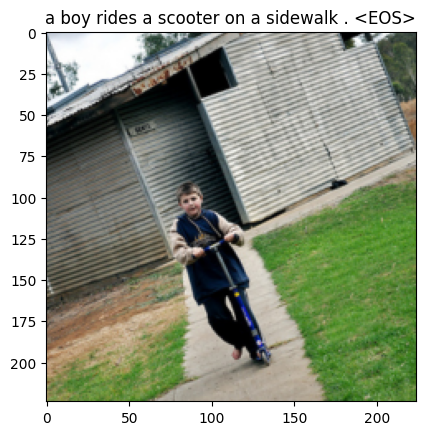

Epoch: 54 loss: 1.39826


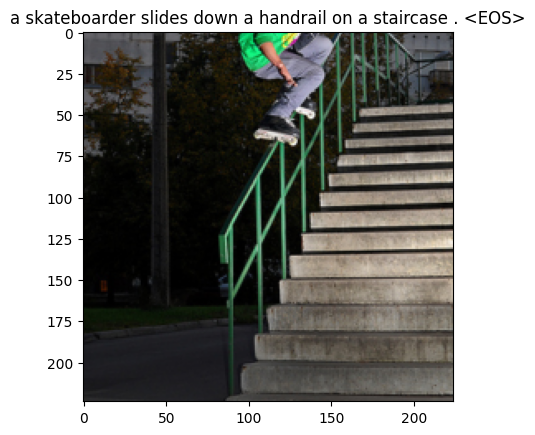

Epoch: 55 loss: 1.40988


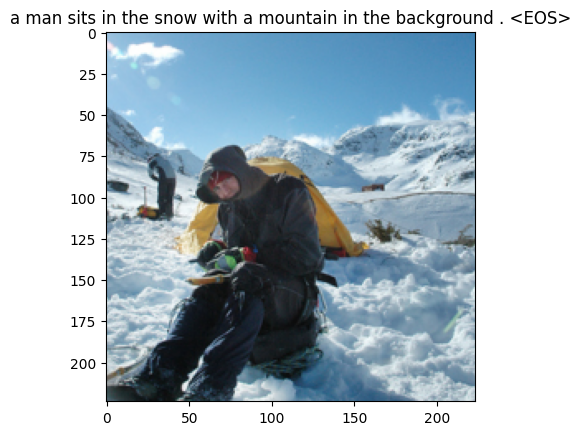

Epoch: 56 loss: 1.37695


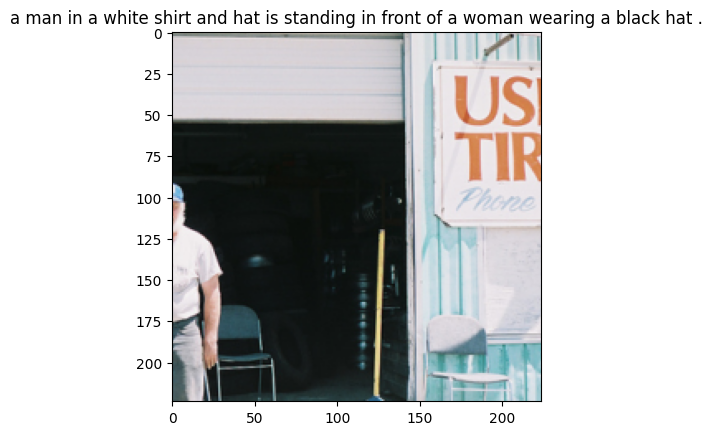

Epoch: 57 loss: 1.34240


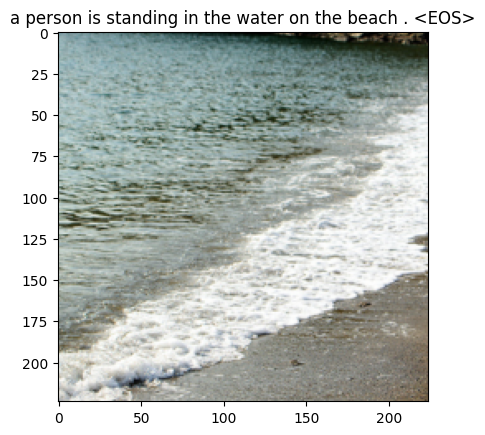

Epoch: 58 loss: 1.33309


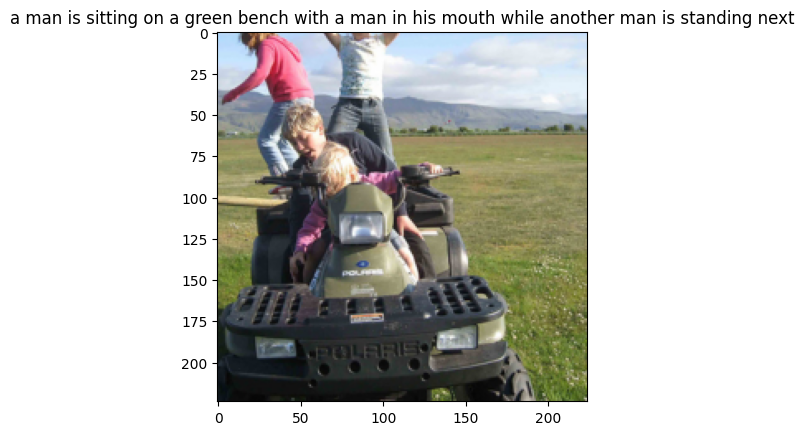

Epoch: 59 loss: 1.27554


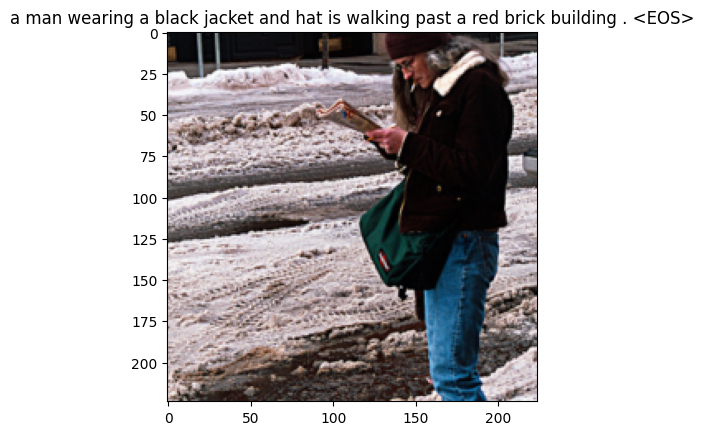

Epoch: 60 loss: 1.26421


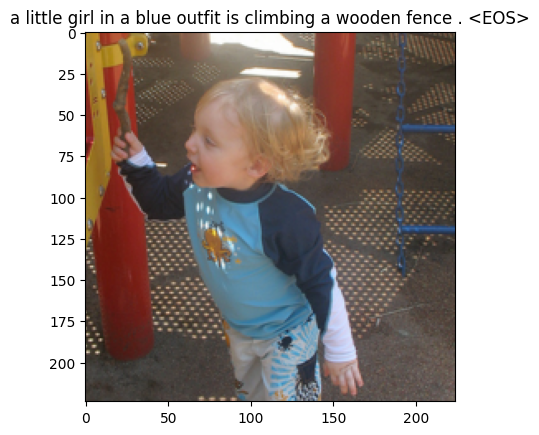

Epoch: 61 loss: 1.34668


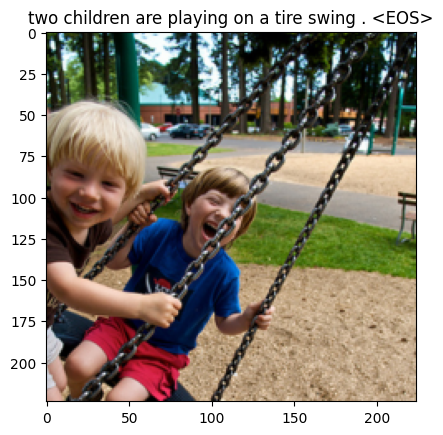

Epoch: 62 loss: 1.22836


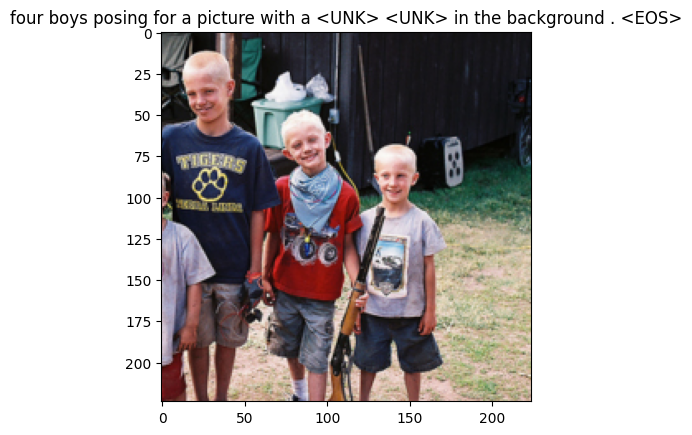

Epoch: 63 loss: 1.25357


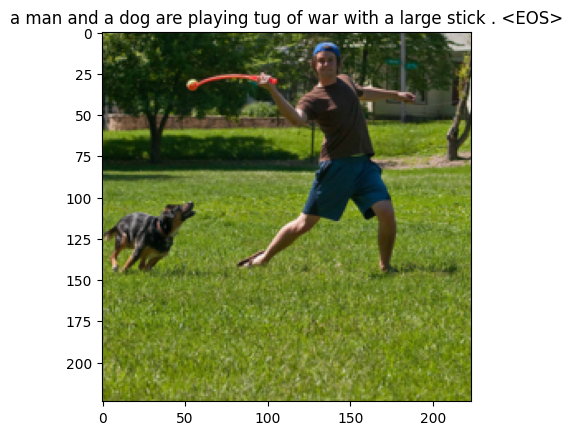

Epoch: 64 loss: 1.19184


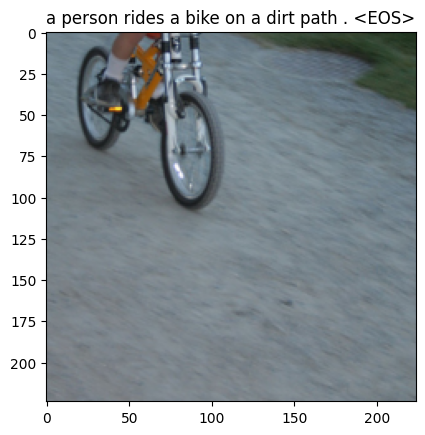

Epoch: 65 loss: 1.22406


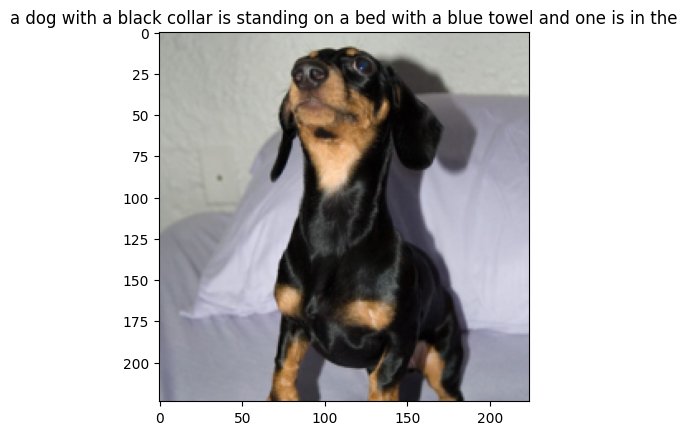

Epoch: 66 loss: 1.20476


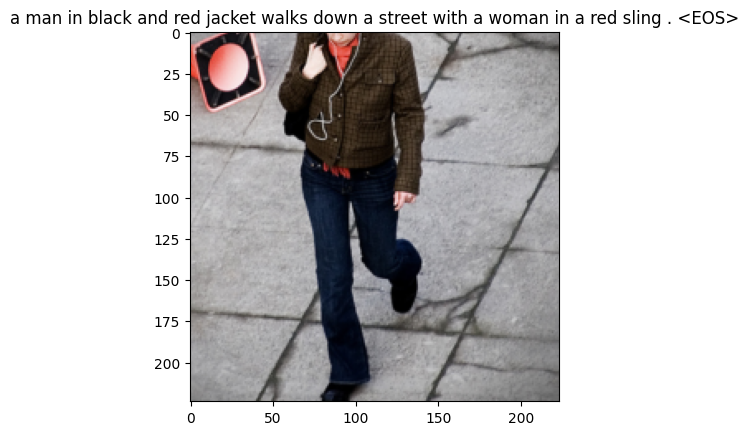

Epoch: 67 loss: 1.20730


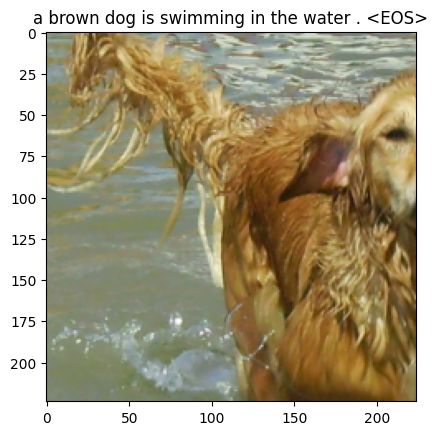

Epoch: 68 loss: 1.23315


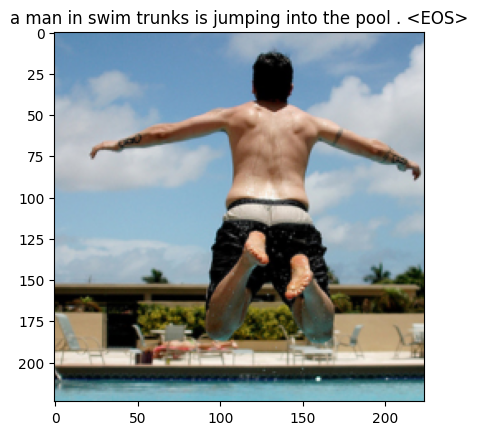

Epoch: 69 loss: 1.20546


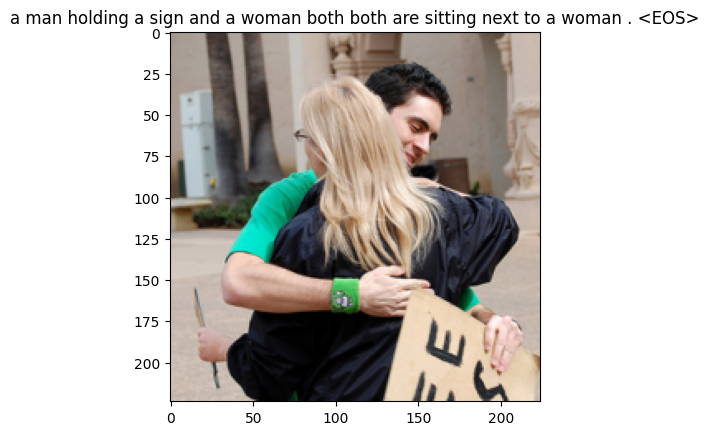

Epoch: 70 loss: 1.17497


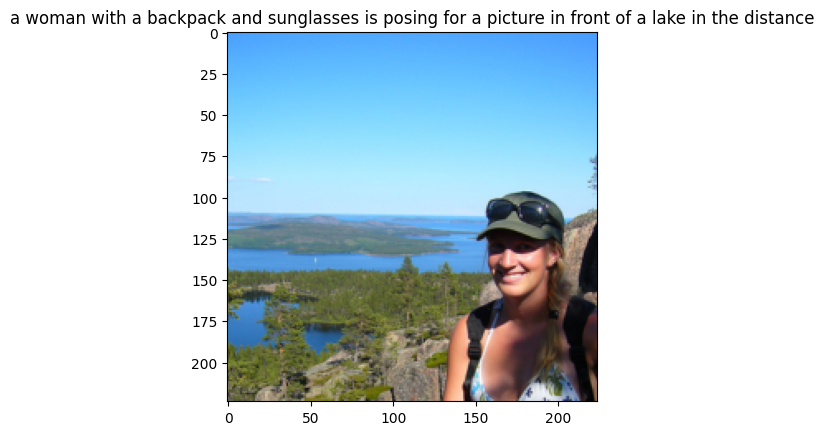

Epoch: 71 loss: 1.17672


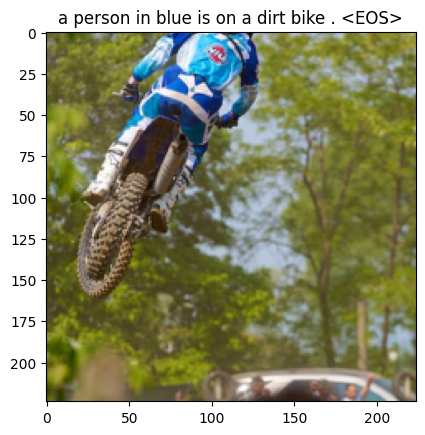

Epoch: 72 loss: 1.16136


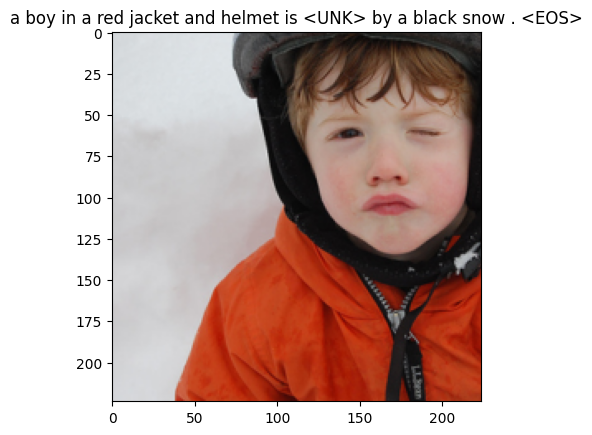

Epoch: 73 loss: 1.16172


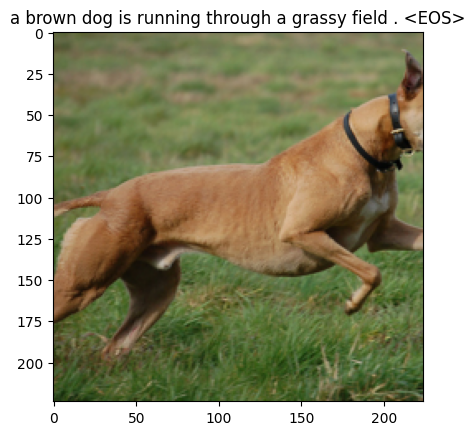

Epoch: 74 loss: 1.11071


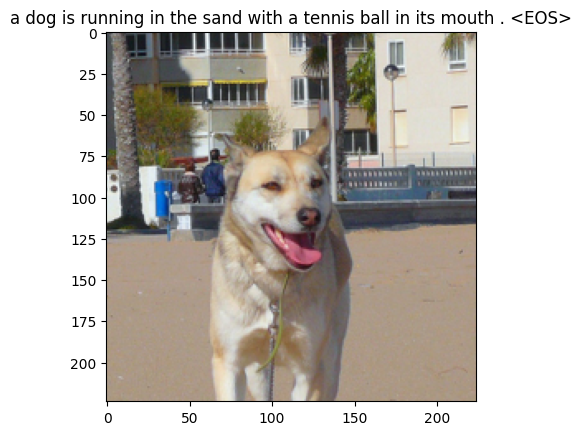

Epoch: 75 loss: 1.14558


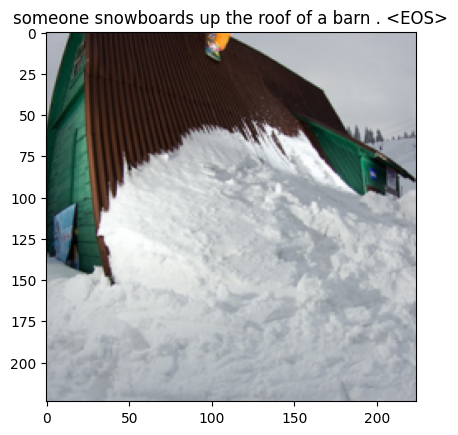

Epoch: 76 loss: 1.12795


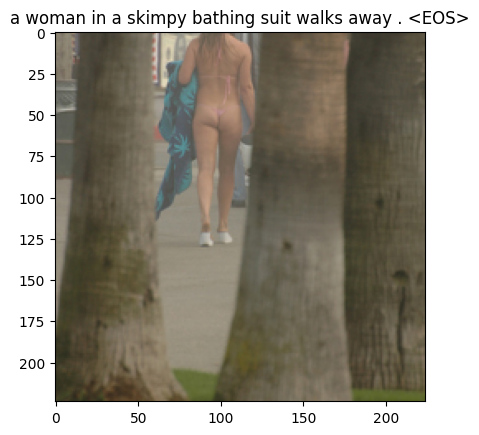

Epoch: 77 loss: 1.06031


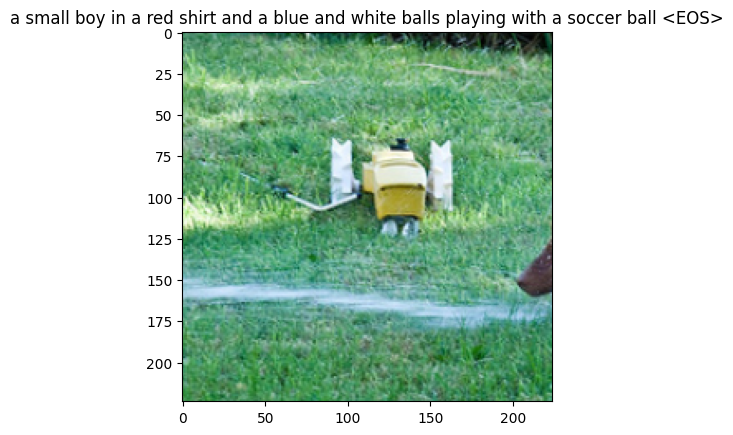

Epoch: 78 loss: 1.04634


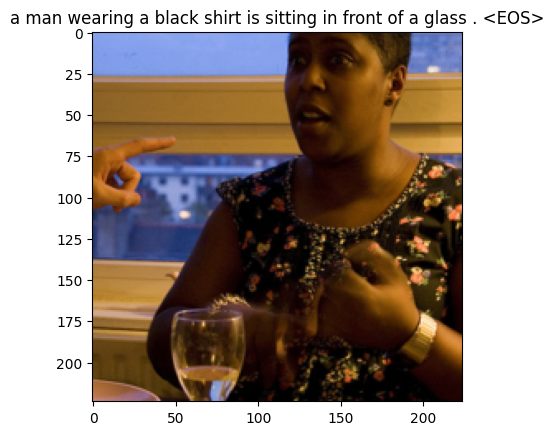

Epoch: 79 loss: 1.04475


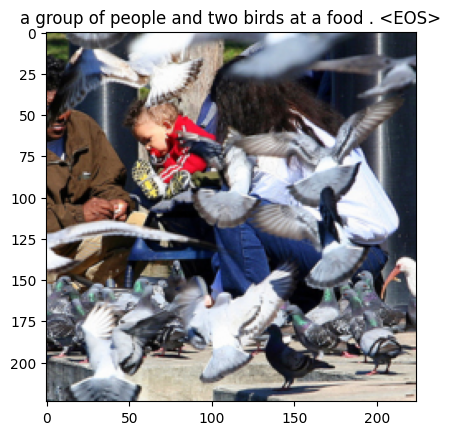

Epoch: 80 loss: 1.06998


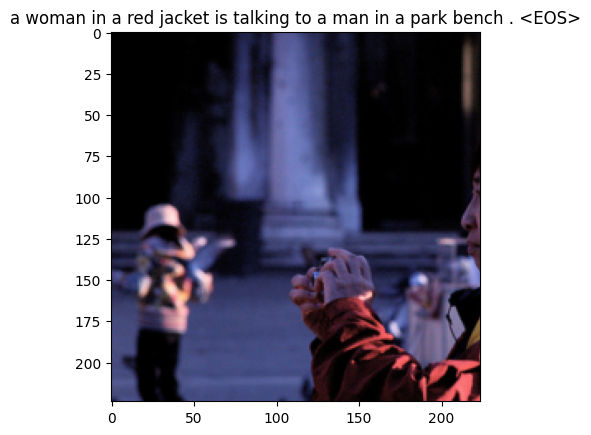

Epoch: 81 loss: 1.06064


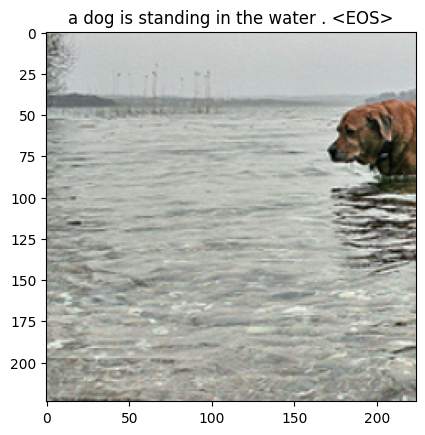

Epoch: 82 loss: 1.02038


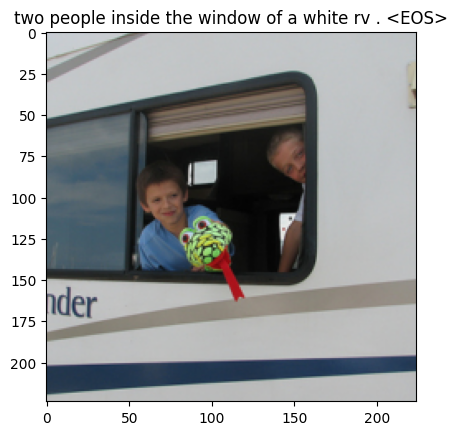

Epoch: 83 loss: 1.07320


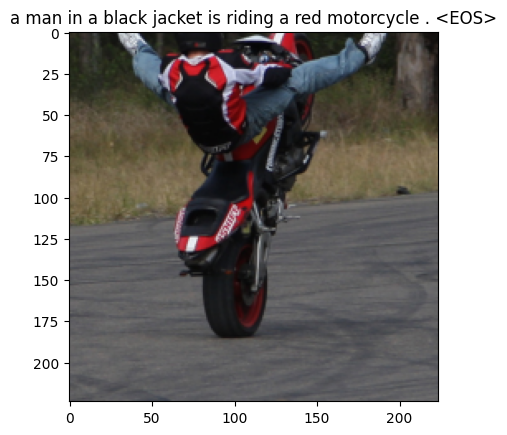

Epoch: 84 loss: 1.01308


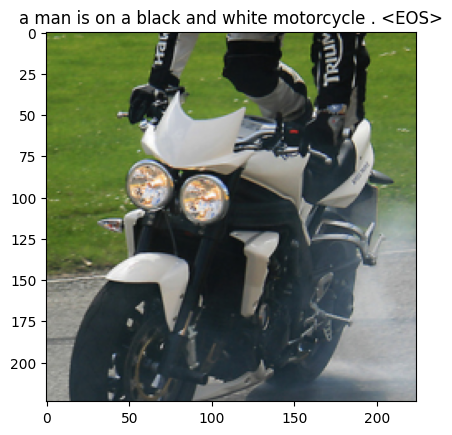

Epoch: 85 loss: 0.99961


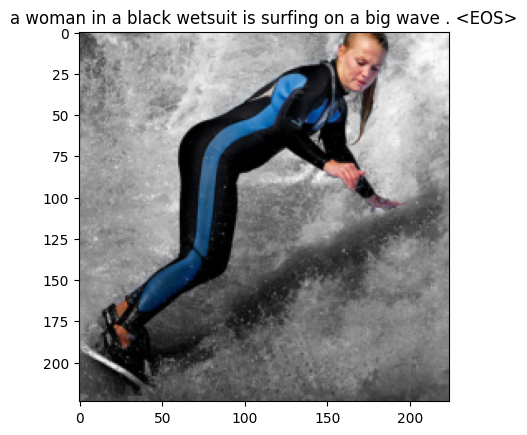

Epoch: 86 loss: 1.03331


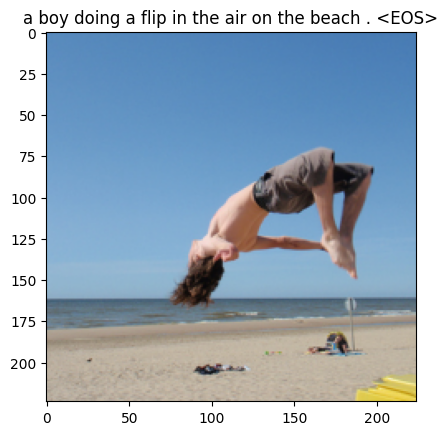

Epoch: 87 loss: 1.00906


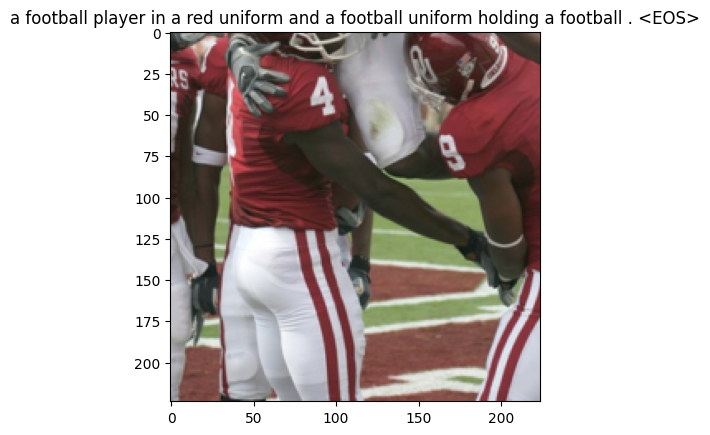

Epoch: 88 loss: 0.99247


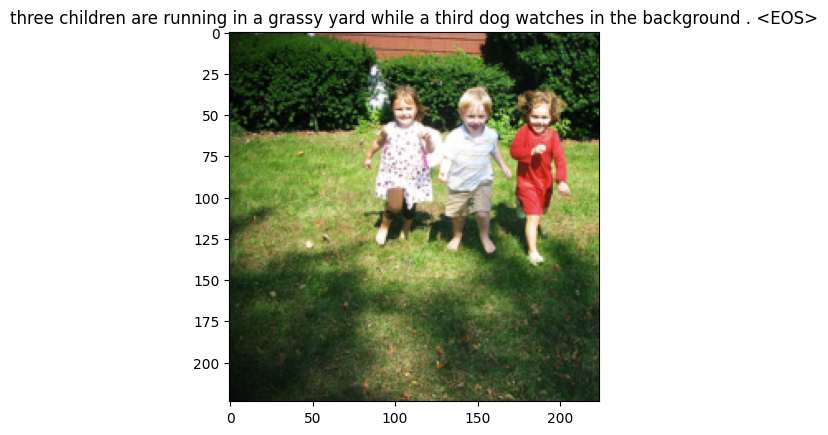

Epoch: 89 loss: 1.01171


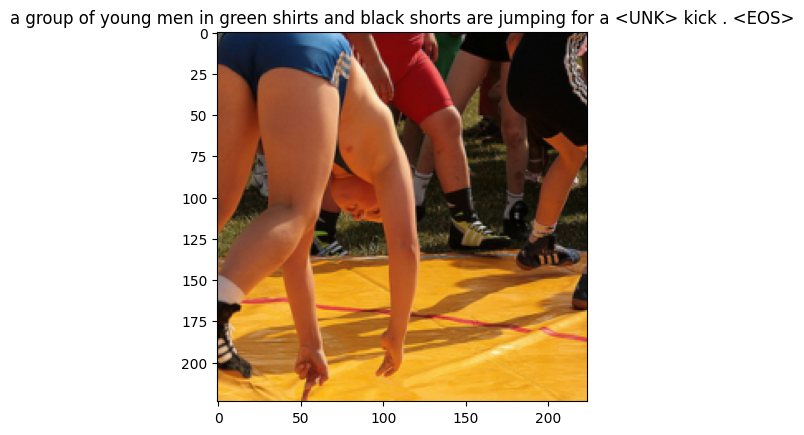

Epoch: 90 loss: 0.98412


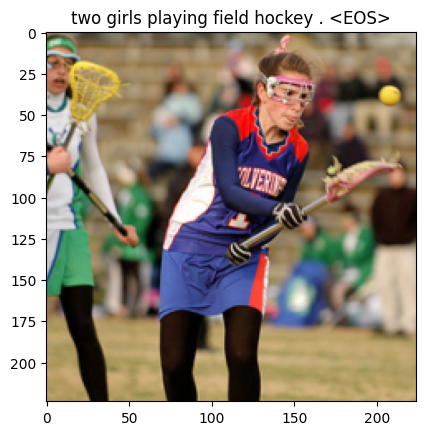

Epoch: 91 loss: 0.98184


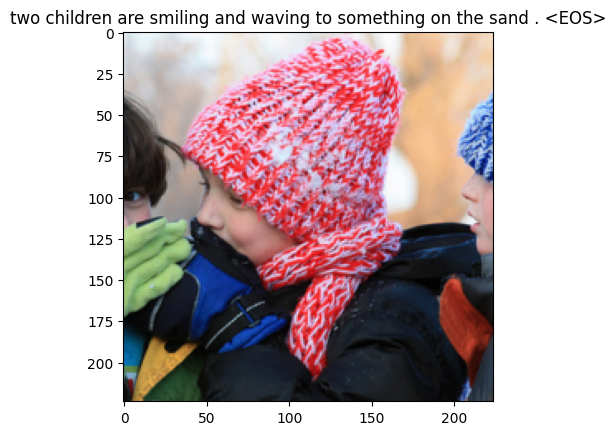

Epoch: 92 loss: 1.00494


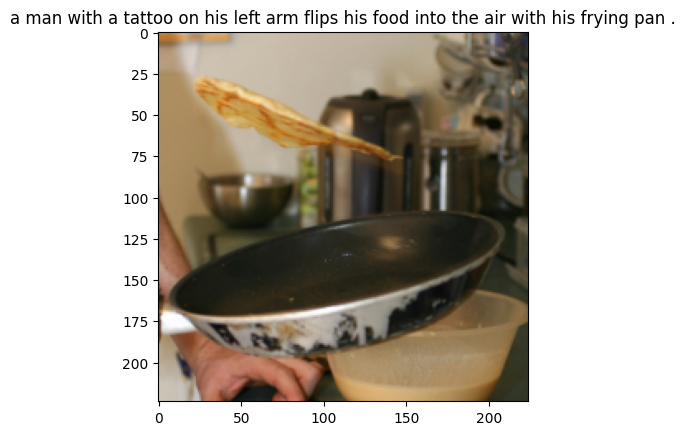

Epoch: 93 loss: 0.93834


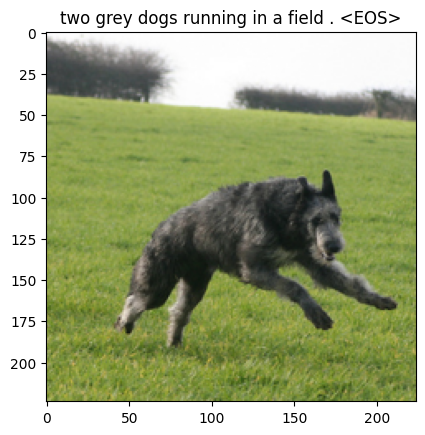

Epoch: 94 loss: 0.98018


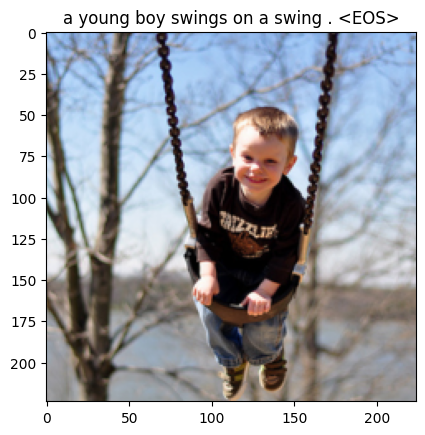

Epoch: 95 loss: 0.95112


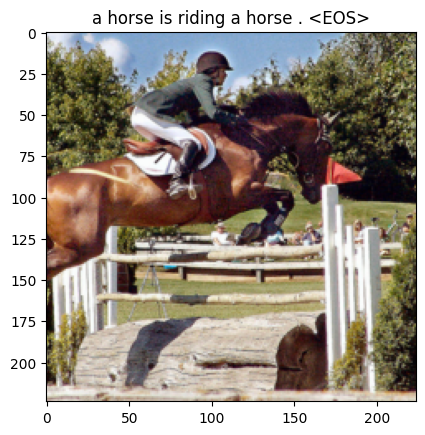

Epoch: 96 loss: 0.94462


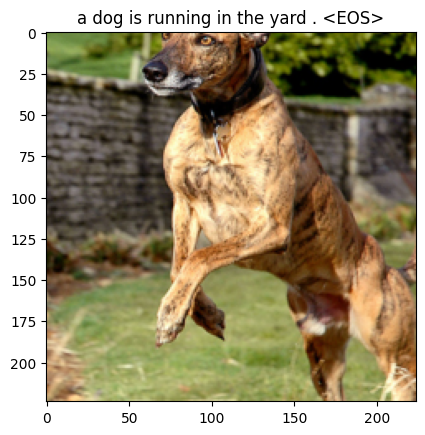

Epoch: 97 loss: 0.92984


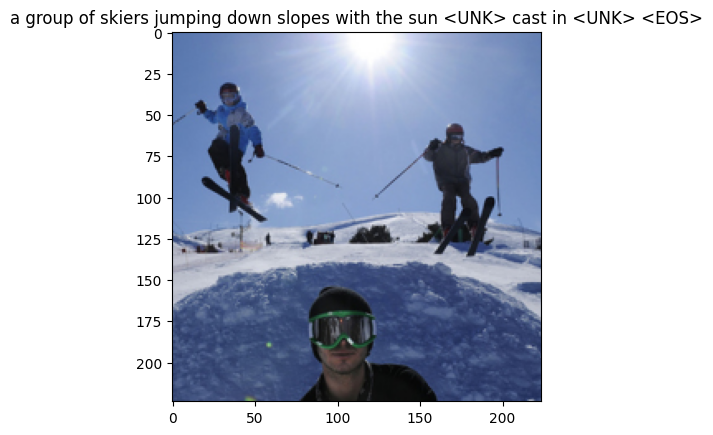

Epoch: 98 loss: 0.89246


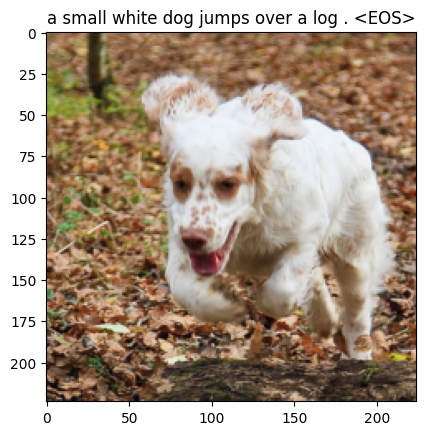

Epoch: 99 loss: 0.93649


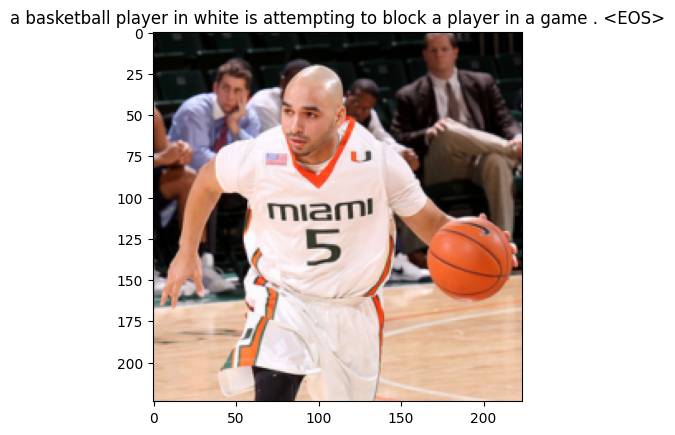

Epoch: 100 loss: 0.88547


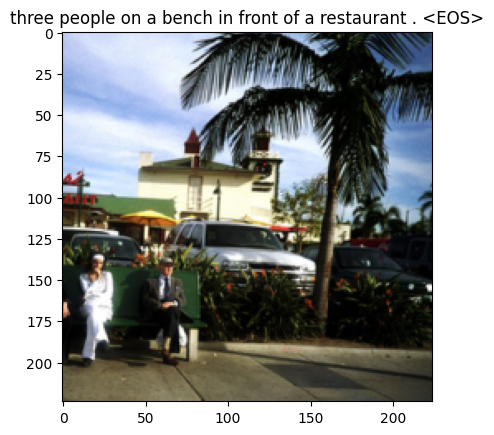

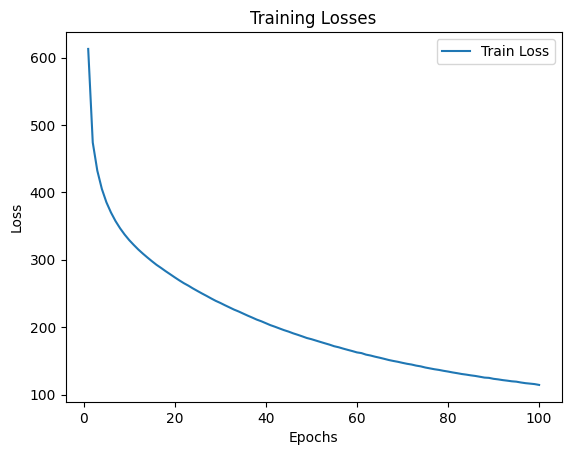

In [17]:
train(model_no_attention, learning_rate, num_epochs, train_loader, dataset)

# Test

In [18]:
from nltk.translate.bleu_score import corpus_bleu
references=[]
candidates=[]
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
for idx,(image,caption) in enumerate(iter(validation_loader)):
    for k in range(image.size()[0]):
        features=model_no_attention.encoder(image[k].unsqueeze(0).to(device))
        caps = model_no_attention.decoder.generate_caption(features,vocab=dataset.vocab)
        reference=[dataset.vocab.itos[i] for i in caption[k].tolist() if dataset.vocab.itos[i]!="<PAD>"]
        references.append(reference)
        candidates.append(caps)

In [19]:
print("bleu 1 score : ",corpus_bleu(references,candidates,weights=(1,0,0,0)))
print("bleu 2 score : ",corpus_bleu(references,candidates,weights=(0.5,0.5,0,0)))
print("bleu 3 score : ",corpus_bleu(references,candidates,weights=(0.33,0.33,0.33,0)))
print("bleu 4 score : ",corpus_bleu(references,candidates,weights=(0.25,0.25,0.25,0.25)))

/opt/conda/lib/python3.10/site-packages/nltk/translate/bleu_score.py:490: UserWarning: 
Corpus/Sentence contains 0 counts of 2-gram overlaps.
BLEU scores might be undesirable; use SmoothingFunction().
  warnings.warn(_msg)


bleu 1 score :  0.11471323556849138
bleu 2 score :  0.338693424158916
bleu 3 score :  0.4894095783087284
bleu 4 score :  0.581973731502476
